### Load example video 
About construction with scenes of trucks, dirt, forests, abd interviews of people. want to test if the weighting embedding aligns with images in imagenet-mini with highest activating neurons. hypothesize that imagenet-mini is too small

mp4 available to view in test_examples/sample_0.mp4

In [ ]:
print("start")
import json
import os
from queryscoring import similarity_queryscoring
import torch
from torch.utils.data import DataLoader, IterableDataset
from datasets import load_dataset
from transformers import CLIPModel, CLIPProcessor
from huggingface_hub import login
from datasets import load_from_disk
from torch.utils.data import Dataset

from sae.config import SaeConfig, TrainConfig
from sae.trainer import SaeTrainer  

from PIL import Image


print("HERE0")
dataset = load_dataset("HuggingFaceFV/finevideo", split="train", streaming=True)
print("HERE1")
def is_desired_category(sample):
    return sample['json']['content_parent_category'] == desired_category

# filtered_dataset = filter(is_desired_category, dataset)

# Create directories to save videos and metadata
os.makedirs("test_examples_hitchhiker", exist_ok=True)


for idx, sample in enumerate(dataset):
    print("here")
    video_filename = f"test_examples_hitchhiker/sample_{idx}.mp4"
    with open(video_filename, 'wb') as video_file:
        video_file.write(sample['mp4'])

    json_filename = f"test_examples_hitchhiker/sample_{idx}.json"
    with open(json_filename, 'w') as json_file:
        json.dump(sample['json'], json_file)
    break
print("done")

### convert video into frames, run through clip to get embeddings

In [23]:
import os
import clip
import cv2
from collections import OrderedDict
import torch
import decord
import numpy as np
from PIL import Image

def read_video_decord(video_path, num_frames):
    video_reader = decord.VideoReader(video_path, num_threads=0)
    available_frames = len(video_reader)
    num_frames = min(num_frames, available_frames)

    intervals = np.linspace(start=0, stop=available_frames, num=num_frames + 1).astype(int)
    frame_ranges = [(interv, intervals[idx + 1]) for idx, interv in enumerate(intervals[:-1])]
    frame_idxs = [(x[0] + x[1]) // 2 for x in frame_ranges]

    frames = video_reader.get_batch(frame_idxs)
    frames = frames.asnumpy()  # Shape: (num_frames, H, W, C), dtype: uint8

    return frames

model, preprocess = clip.load("ViT-B/32")
model.cuda().eval()

video_path = "test_examples_hitchhiker/sample_0.mp4"
num_frames = 50  
frames_np = read_video_decord(video_path, num_frames)

pil_images = [Image.fromarray(frame) for frame in frames_np]
preprocessed_images = [preprocess(img) for img in pil_images]
preprocessed_batch = torch.stack(preprocessed_images).cuda()  # Shape: (num_frames, 3, 224, 224)

with torch.no_grad():
    image_features = model.encode_image(preprocessed_batch)
    image_features /= image_features.norm(dim=-1, keepdim=True)
    

text_prompts = ["construction hardhat dirt truck forest operator operator"]
text_tokens = clip.tokenize(text_prompts).cuda()

with torch.no_grad():
    text_features = model.encode_text(text_tokens)
    text_features /= text_features.norm(dim=-1, keepdim=True)



print(text_features.size())
print(image_features.size())

[h264 @ 0x5c85e440] mmco: unref short failure


torch.Size([1, 512])
torch.Size([50, 512])


### calculate similarity scores with clip model according to CLIP HITCHHIKER

In [25]:
def similarity_queryscoring(text_embeds, vid_embeds, temperature=0.1, eps=1e-8, mean='scores'):
    """
    :param text_embeds: Tensor of shape [b_t, d]
    :param vid_embeds: Tensor of shape [b_v, v, d]
    :param temperature: float
    :param eps: float
    :param mean: str 'feats' or 'scores', what to average over. Query-scoring default SOTA is mean over feats
    :return: Tensor, Tensor of shape [b_t, b_v] and [b_v, b_t]. Similarity scores.
    """
    vid_embeds = image_features.unsqueeze(0)
    assert len(text_embeds.shape) == 2
    assert len(vid_embeds.shape) == 3

    t_b_n, v_b_n = text_embeds.norm(dim=1)[:, None], vid_embeds.norm(dim=2)[:, :, None]
    text_embeds_norm = text_embeds / torch.max(t_b_n, eps * torch.ones_like(t_b_n))
    vid_embeds_norm = vid_embeds / torch.max(v_b_n, eps * torch.ones_like(v_b_n))

    # calculate similarity between text embeds and every frame embedding
    sim_mt = torch.einsum('a d, b v d -> a b v', text_embeds_norm, vid_embeds_norm)

    # compute "query-scores", temperature is variable parameter
    scores = torch.softmax(sim_mt / temperature, dim=2)
    return scores
    
similarity_scores = similarity_queryscoring(text_features, image_features)

print(similarity_scores)

tensor([[[0.0230, 0.0232, 0.0256, 0.0269, 0.0305, 0.0312, 0.0370, 0.0302,
          0.0122, 0.0188, 0.0165, 0.0324, 0.0308, 0.0177, 0.0175, 0.0168,
          0.0162, 0.0266, 0.0157, 0.0163, 0.0125, 0.0089, 0.0096, 0.0205,
          0.0200, 0.0124, 0.0183, 0.0172, 0.0157, 0.0267, 0.0128, 0.0128,
          0.0124, 0.0266, 0.0241, 0.0161, 0.0154, 0.0300, 0.0088, 0.0268,
          0.0285, 0.0279, 0.0259, 0.0174, 0.0133, 0.0120, 0.0121, 0.0149,
          0.0175, 0.0176]]], device='cuda:0', dtype=torch.float16)


### calculate pre activations in clip model layer 9

In [76]:
from sae.sae import Sae
from collections import defaultdict


clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32").eval()
vision_model = clip_model.vision_model
vision_model.to(device)
# print(vision_model.encoder.layers[9])

activations = []
def capture_activation(name):
    def hook(model, input, output):
        activations.append(output[0][:, 0, :].detach())
    return hook

hook_handle = vision_model.encoder.layers[9].register_forward_hook(capture_activation("layer9"))

model_path = "models/clip_sae_9_k32_ex8/vision_model.encoder.layers.9"
device = "cuda"

sae = Sae.load_from_disk(model_path, device).eval()
neurons_topk = defaultdict(list)
i = 0
print(len(preprocessed_batch))
for image in preprocessed_batch:
    
    # if i%1000==0:
    #     print(i)
    #     print("DICT: ", len(neurons_topk))
    #     print(len(neurons_topk[int(idx)]))
    # inp, label = image['input_ids'], image['labels']
    
    image = image.unsqueeze(0)
    vision_model(image)

activations = torch.stack(activations, dim=0)
print(activations.size())
print(similarity_scores.squeeze(0).size())
weighted_embedding = similarity_scores.squeeze(0).float()@activations[:, 0, :]
# print(weighted_embedding)

50
torch.Size([50, 1, 768])
torch.Size([1, 50])


### get top activating neuron indices

In [80]:

top_latent_acts = sae.encode(weighted_embedding).top_indices
print(top_latent_acts)

tensor([[ 647,  651, 1346, 1428, 1570, 1634, 1948, 2079, 2119, 2208, 2415, 2496,
         2756, 2902, 3029, 3041, 3247, 3335, 3395, 3422, 3766, 3936, 4069, 4425,
         4443, 4903, 5179, 5291, 5414, 5676, 6033, 4865]], device='cuda:0')


### investigate top images in imagenet-mini

Showing images for neuron:  647


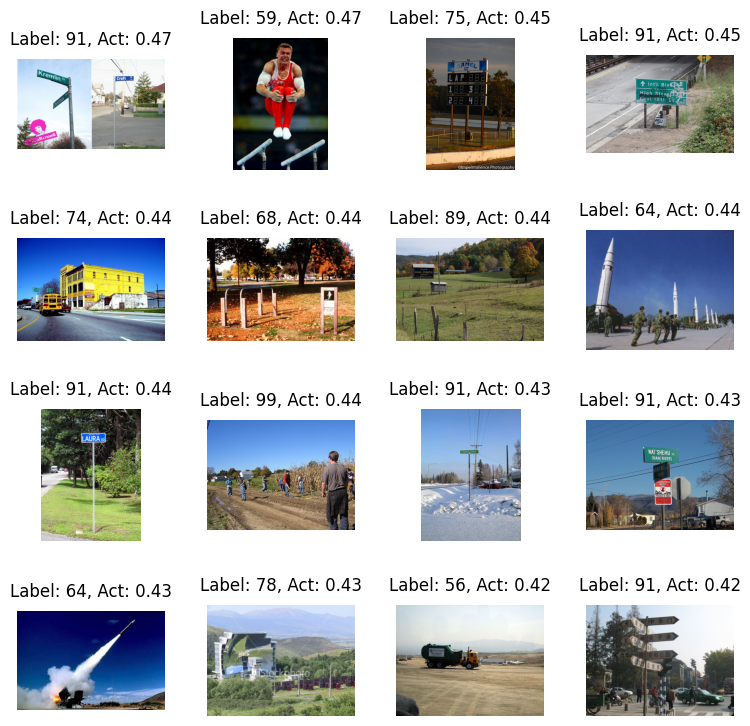

Showing images for neuron:  651


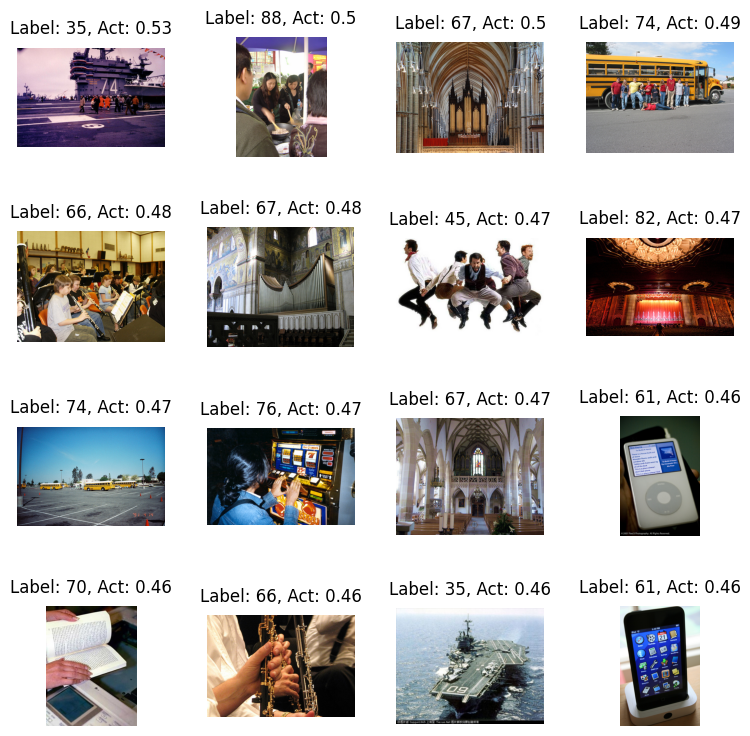

Showing images for neuron:  1346


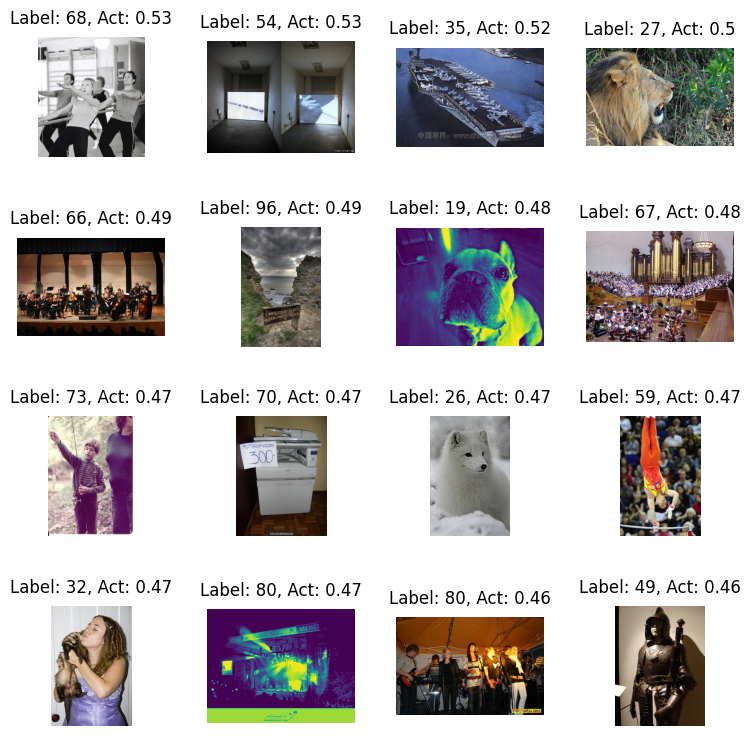

Showing images for neuron:  1428


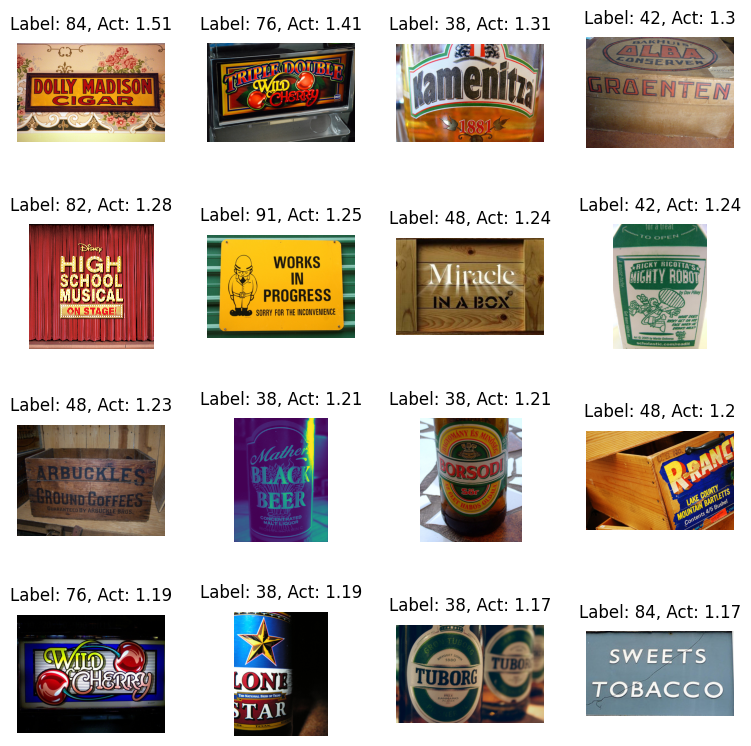

Showing images for neuron:  1570


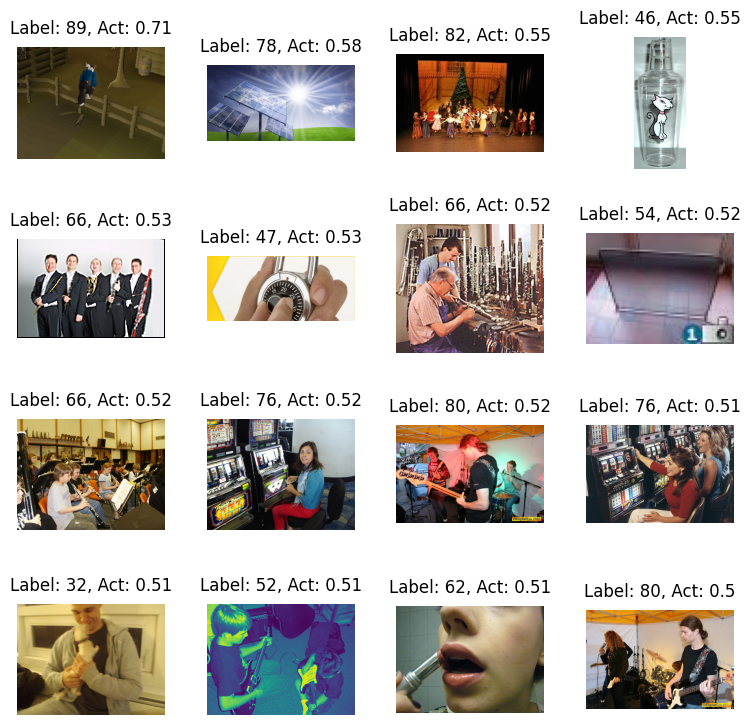

Showing images for neuron:  1634


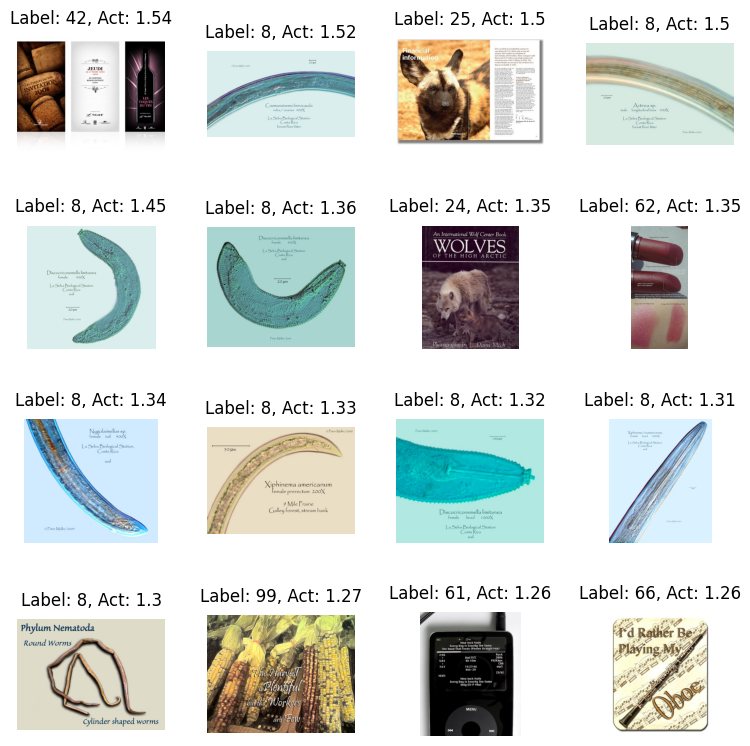

Showing images for neuron:  1948


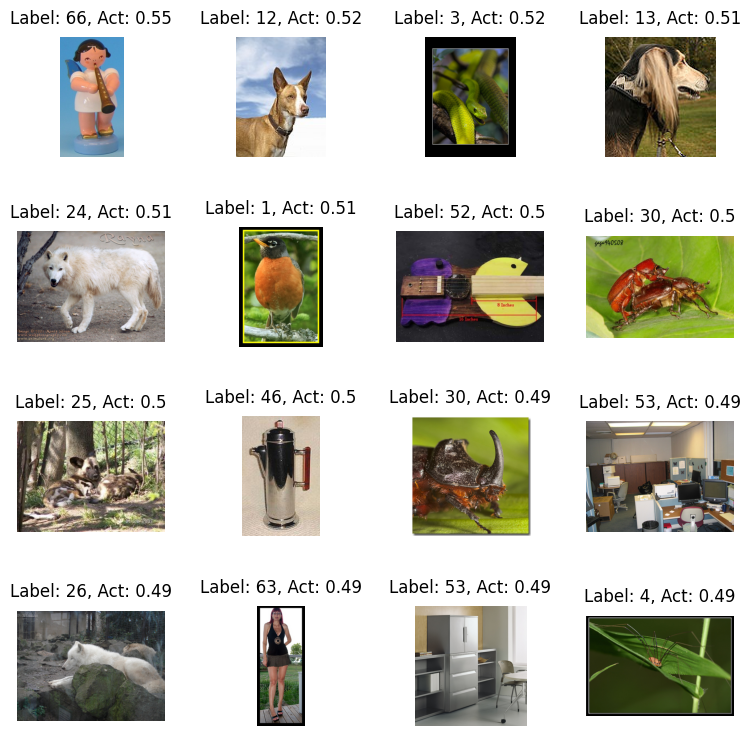

Showing images for neuron:  2079


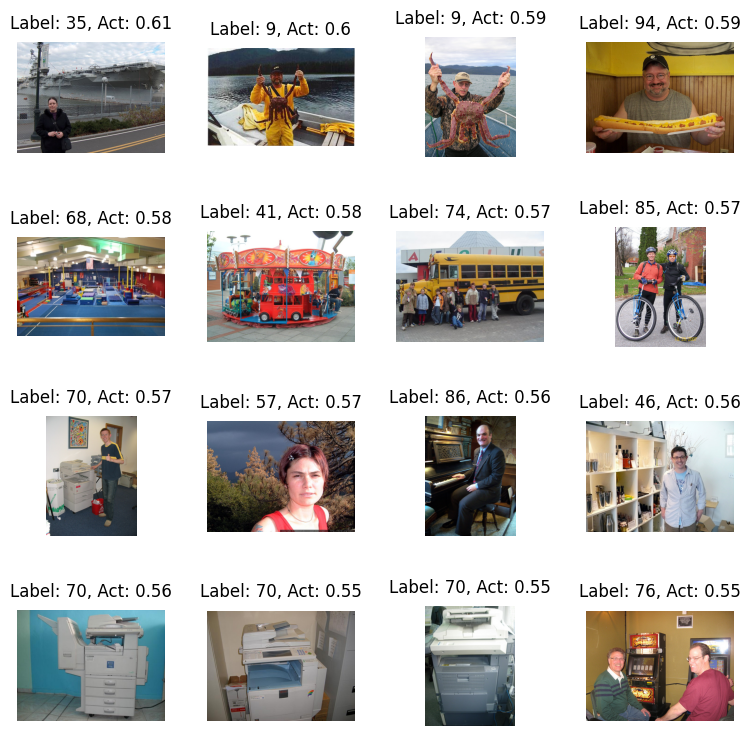

Showing images for neuron:  2119


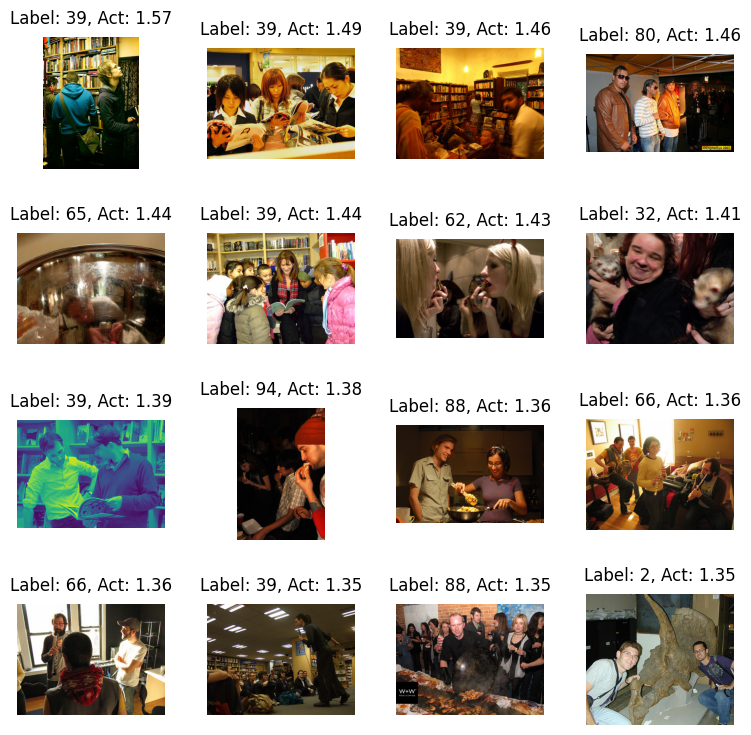

Showing images for neuron:  2208


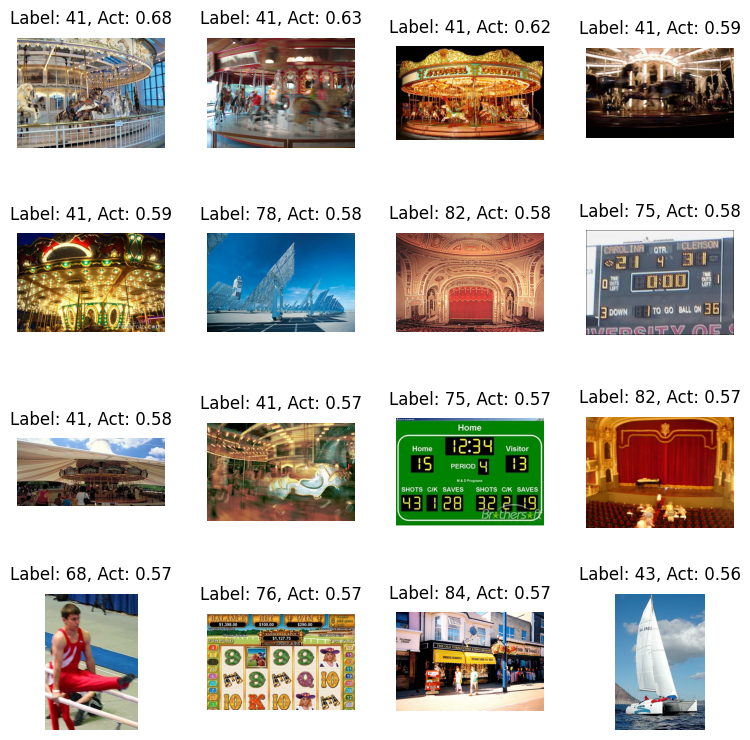

Showing images for neuron:  2415


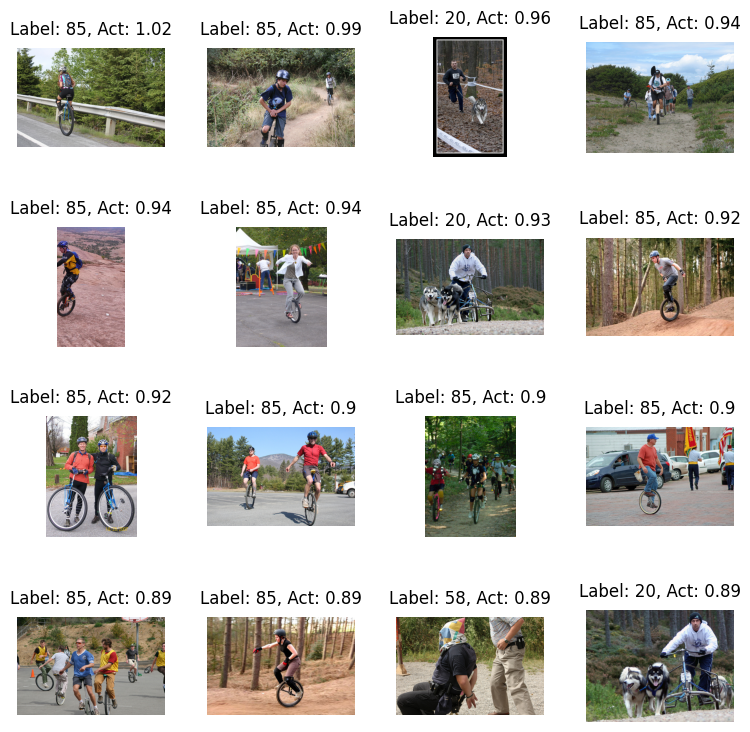

Showing images for neuron:  2496


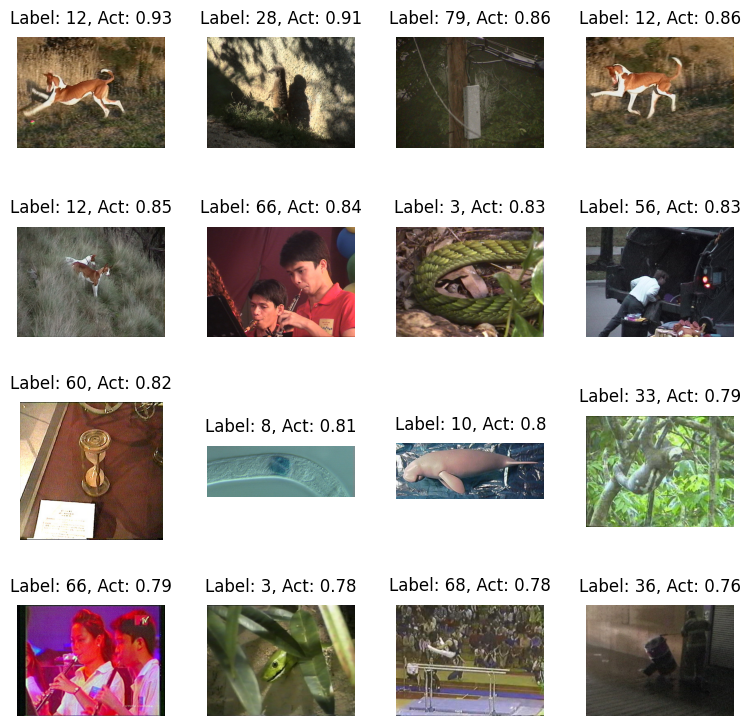

Showing images for neuron:  2756


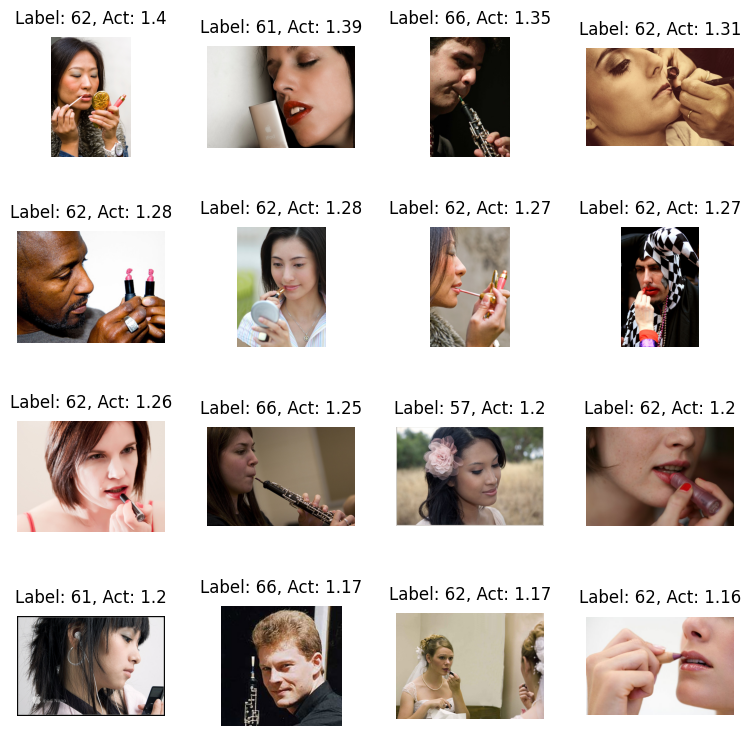

Showing images for neuron:  2902


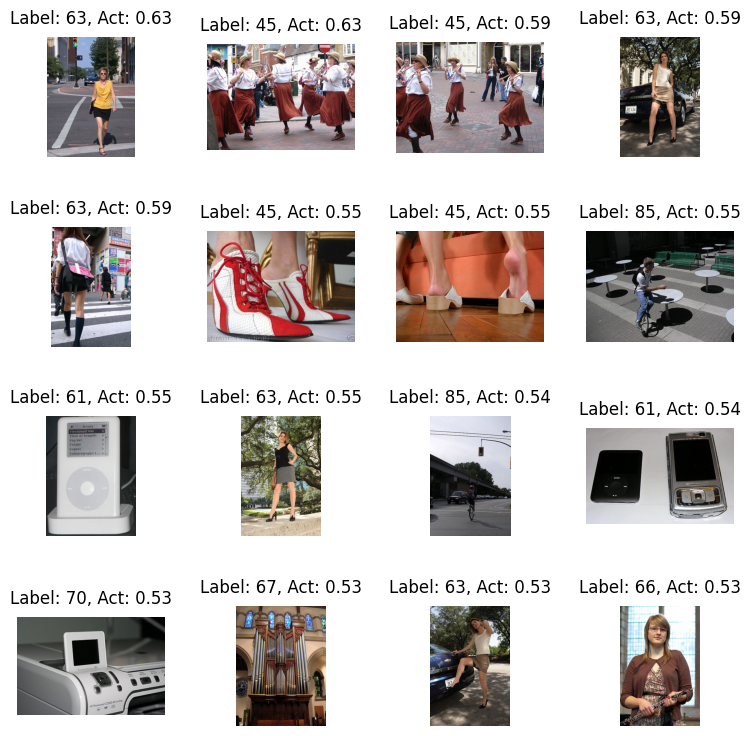

Showing images for neuron:  3029


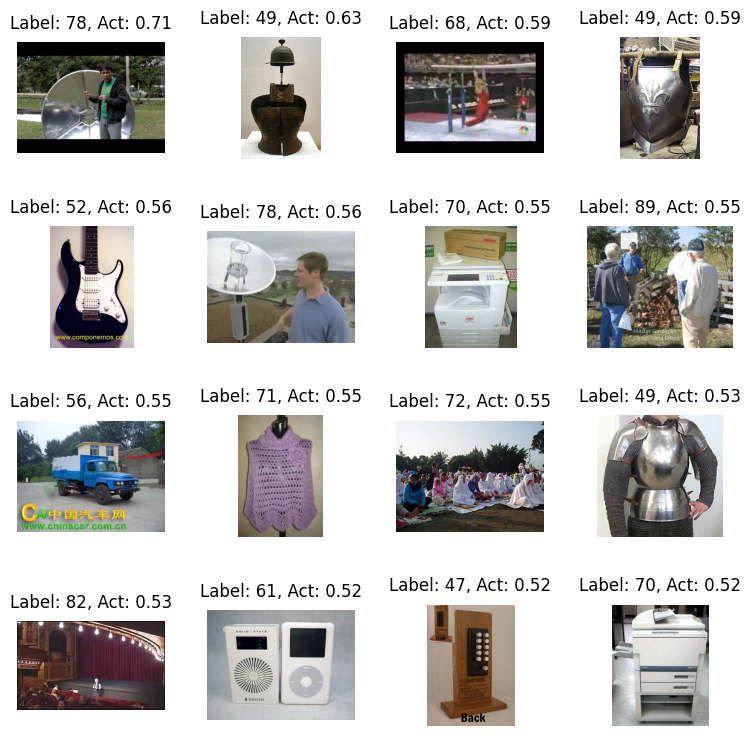

Showing images for neuron:  3041


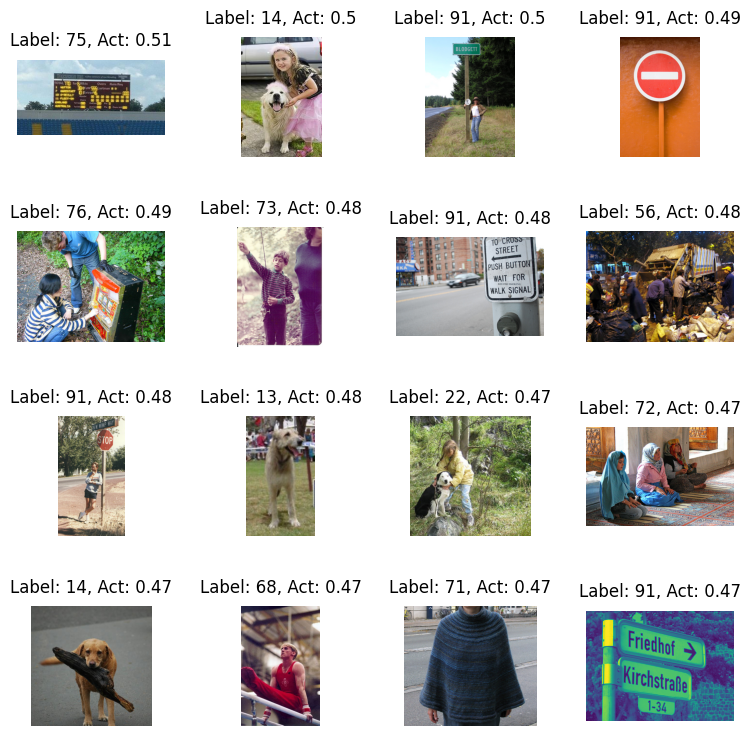

Showing images for neuron:  3247


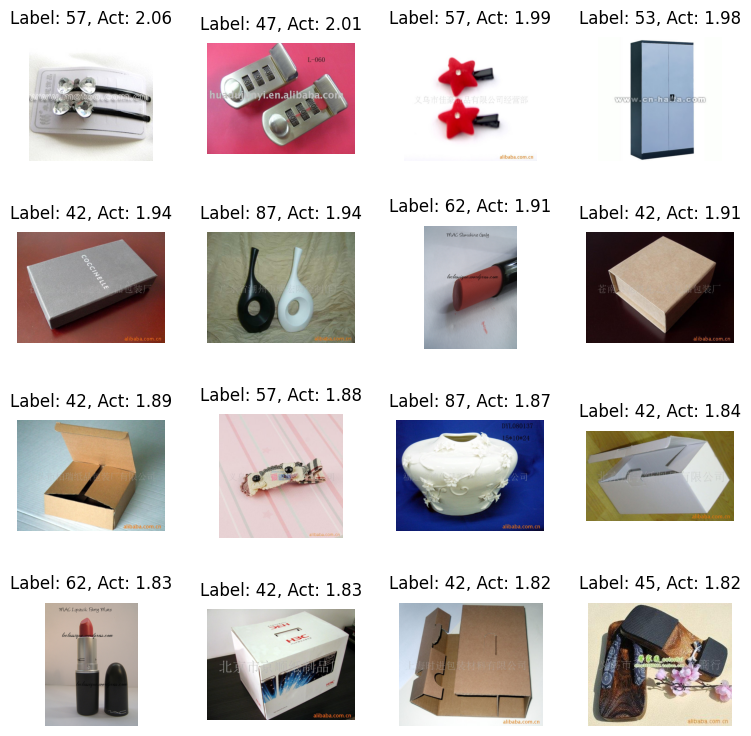

Showing images for neuron:  3335


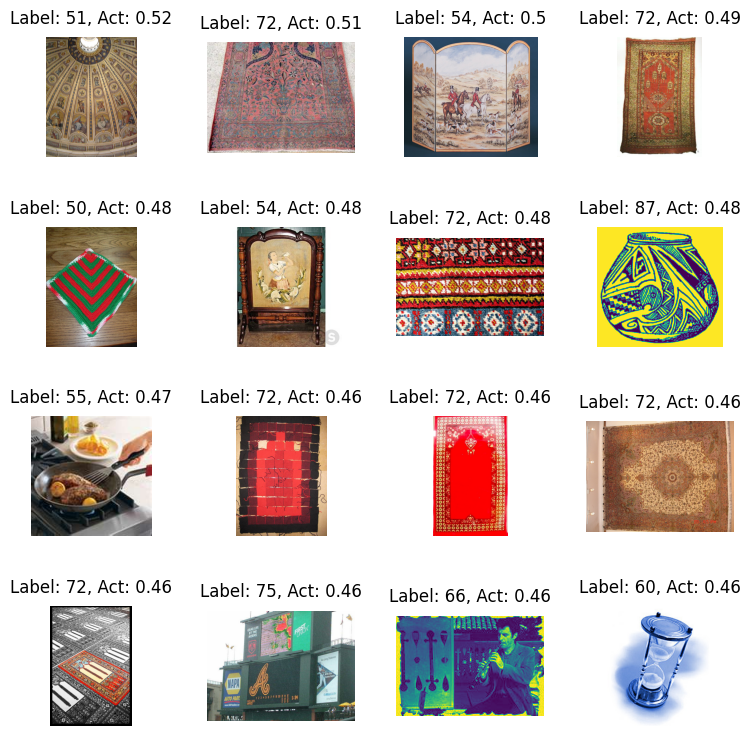

Showing images for neuron:  3395


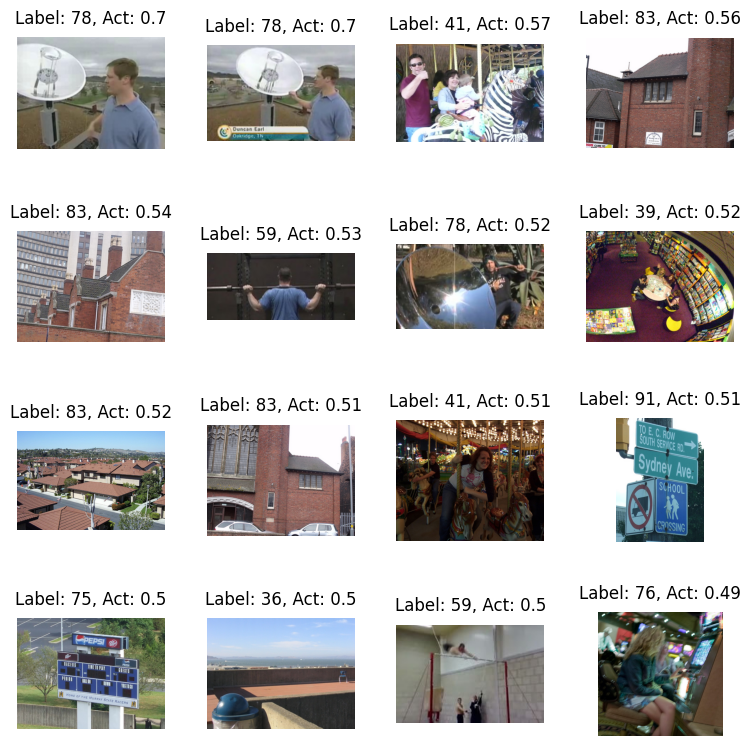

Showing images for neuron:  3422


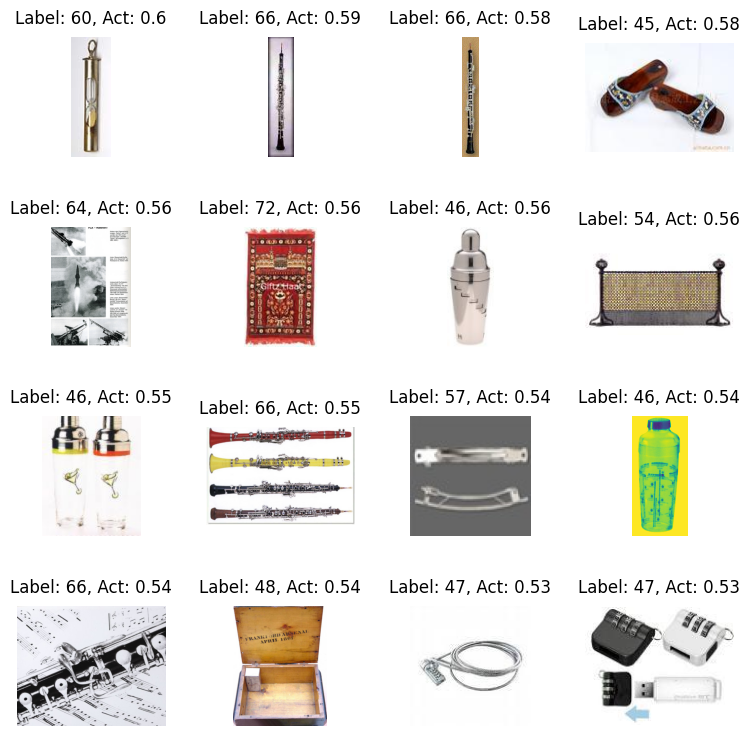

Showing images for neuron:  3766


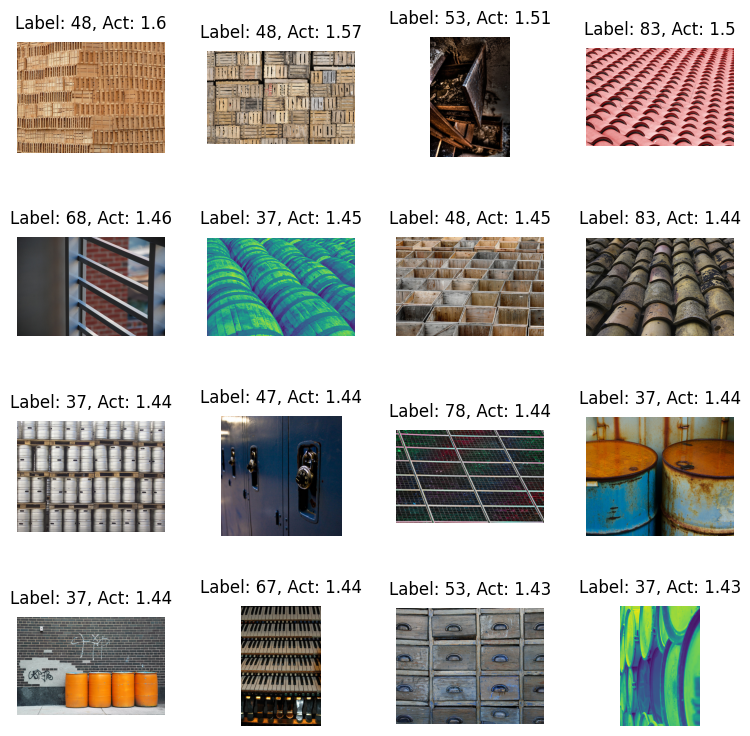

Showing images for neuron:  3936


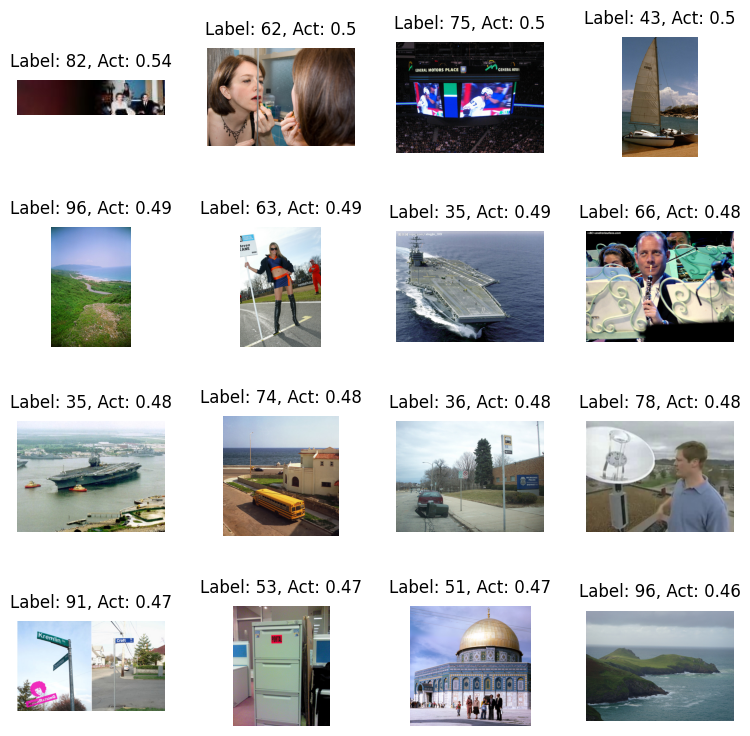

Showing images for neuron:  4069


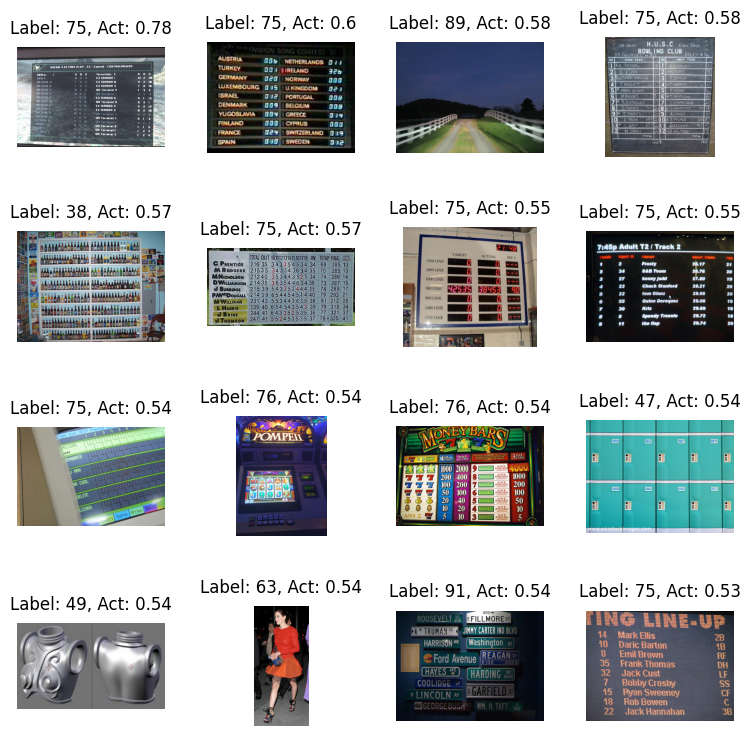

Showing images for neuron:  4425


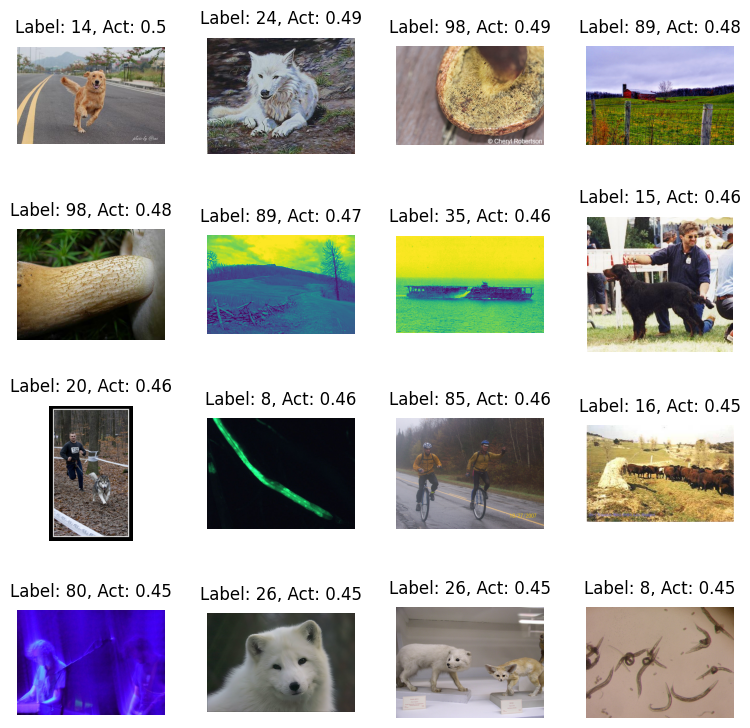

Showing images for neuron:  4443


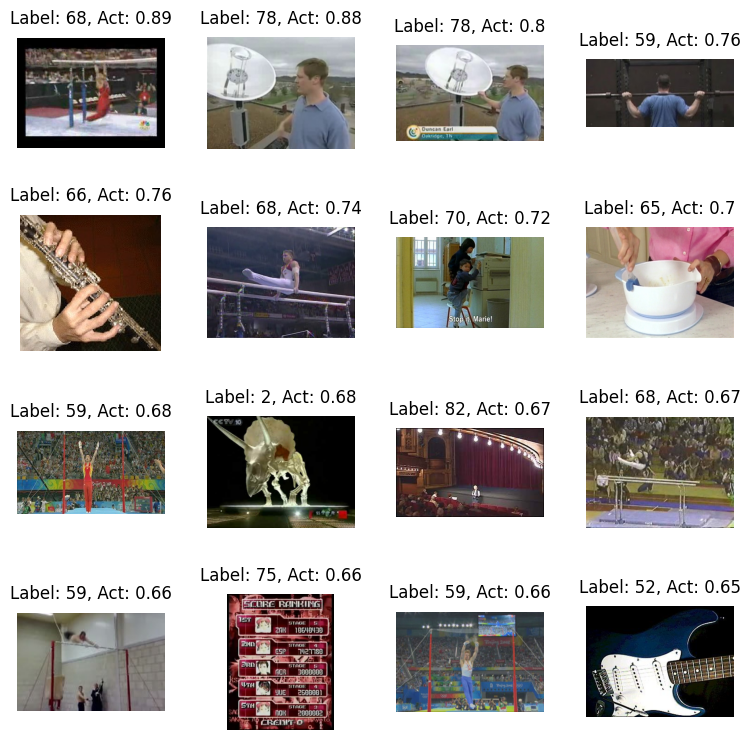

Showing images for neuron:  4903


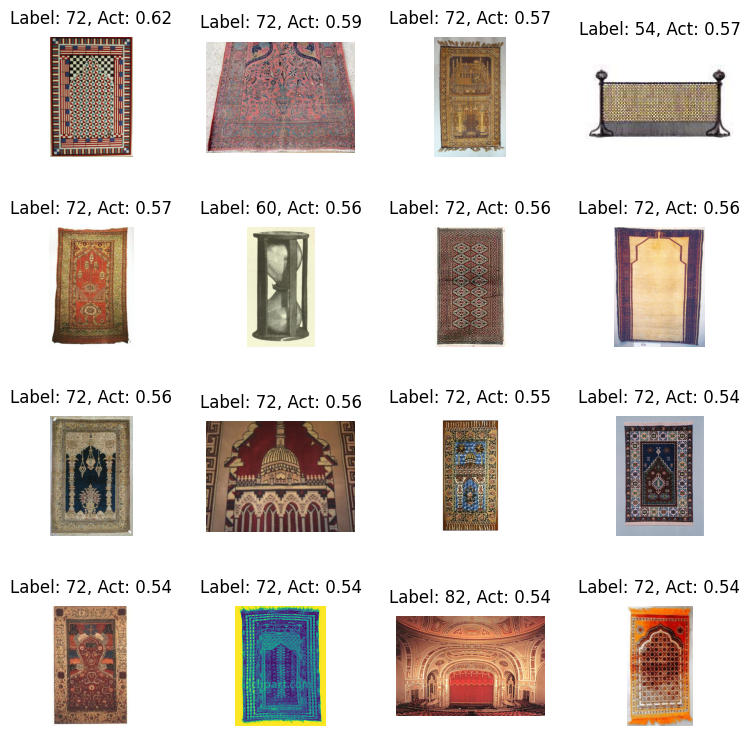

Showing images for neuron:  5179


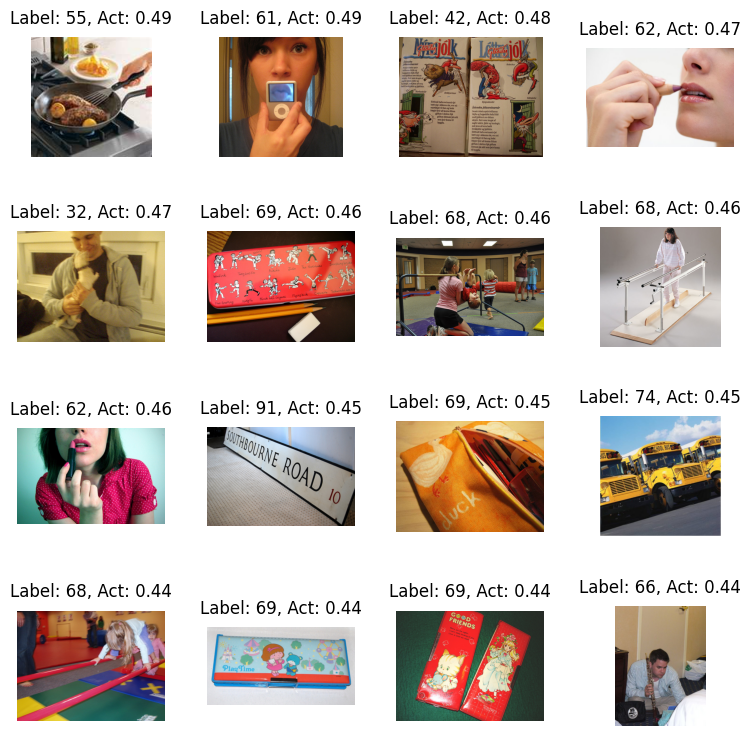

Showing images for neuron:  5291


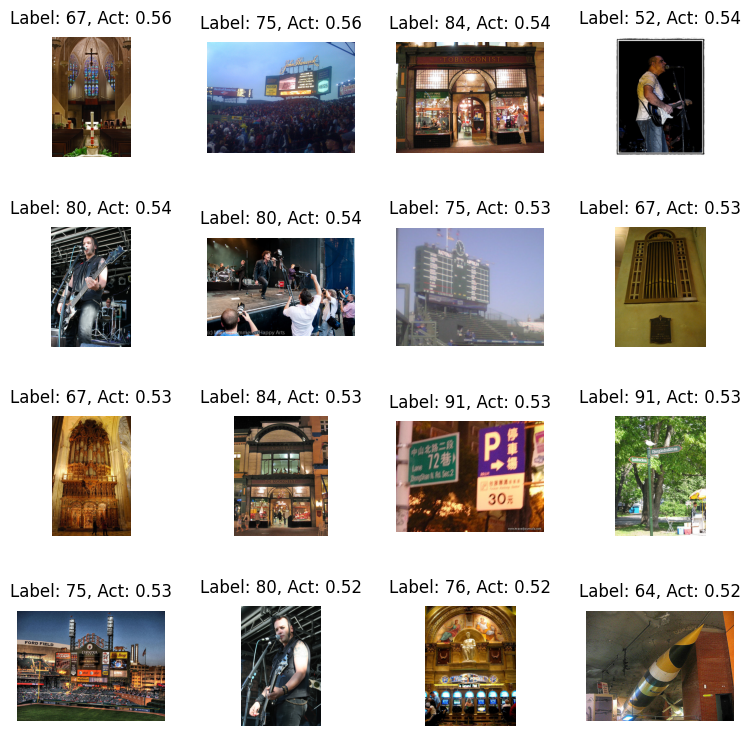

Showing images for neuron:  5414


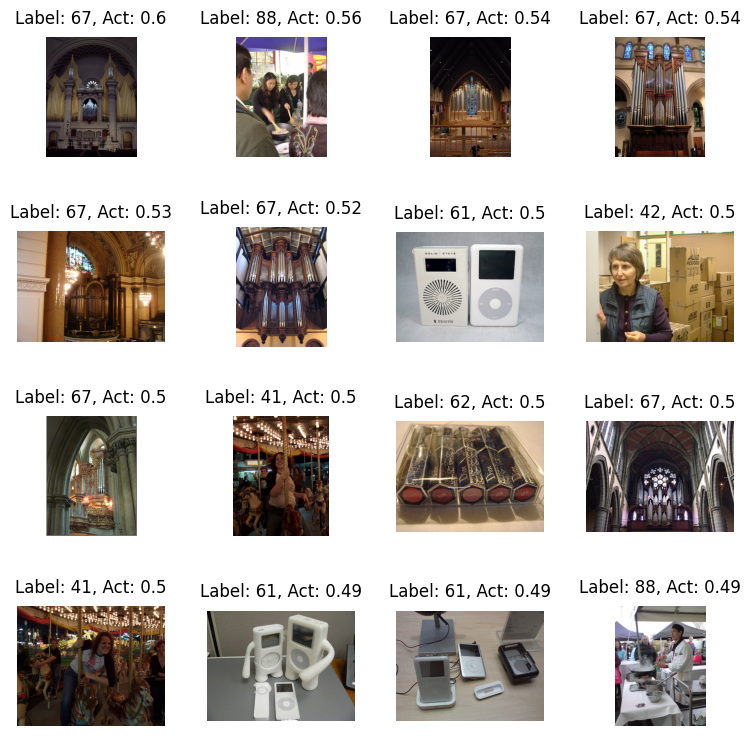

Showing images for neuron:  5676


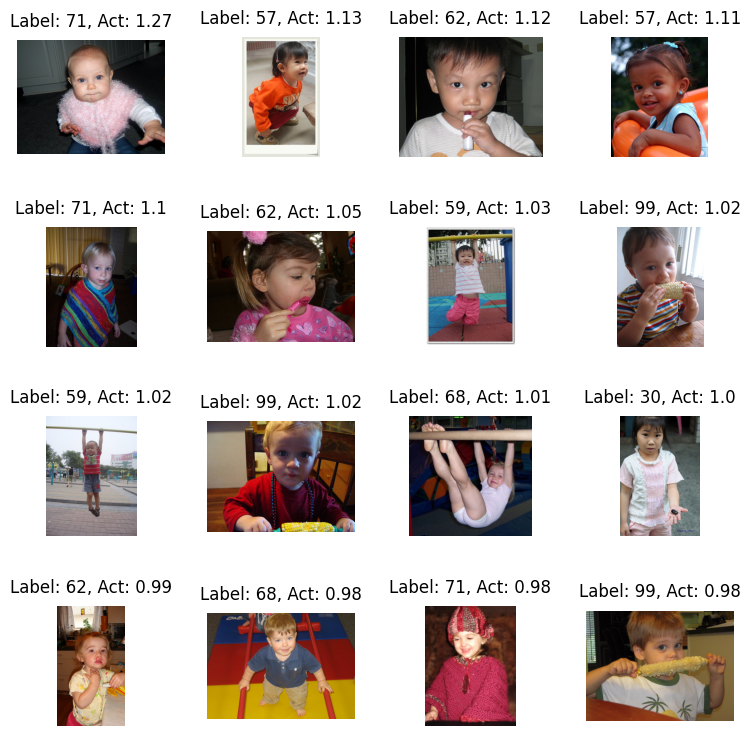

Showing images for neuron:  6033


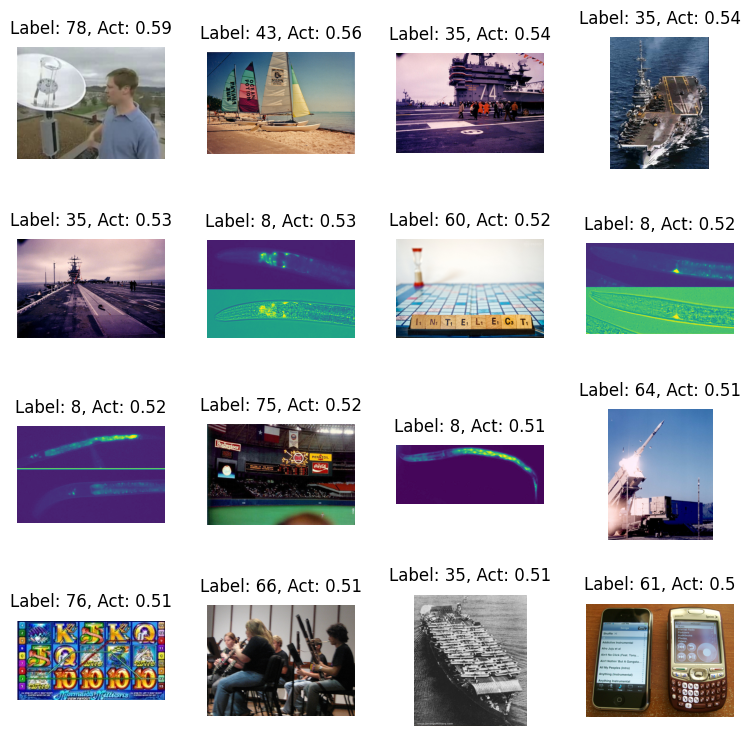

Showing images for neuron:  4865


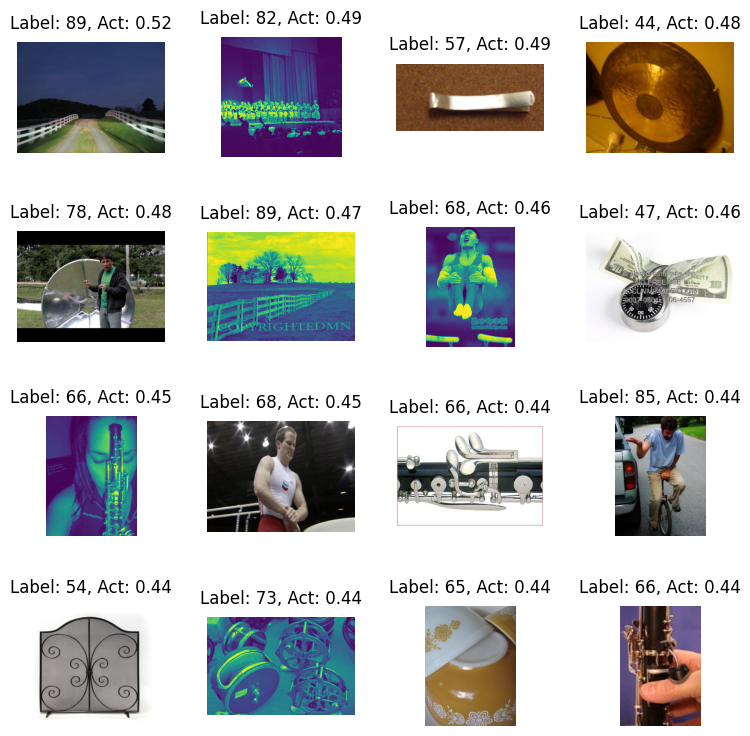

In [78]:
import pickle
from matplotlib import pyplot as plt
def plot_images(images_list, captions_list):
    fig, axes = plt.subplots(4, 4, figsize=(8, 8))  
    axes = axes.flatten()

    for idx, ax in enumerate(axes):
        if idx < len(images_list):
            image = images_list[idx]
            if isinstance(image, Image.Image):
                image = np.array(image)

            ax.imshow(image)
            ax.set_title(captions_list[idx], fontsize=12, pad=10)
        ax.axis('off')

    plt.tight_layout(pad=3.0)
    plt.show(fig)

def load_images_for_neuron(neuron_idx):
    dataset = load_from_disk("mini-imagenet")
    dataset = dataset.shuffle(seed=35)

    with open("neuron_data/second.pkl", "rb") as f:
        neurons_topk = pickle.load(f)

    topk = sorted(neurons_topk[neuron_idx], key=lambda x: -x[2])[:16]

    images_list = []
    captions_list = []
    for idx, label, act in topk:
        idx -= 1  
        if idx < len(dataset):
            images_list.append(dataset[idx]['image'])
            captions_list.append(f"Label: {label}, Act: {round(act, 2)}")
        # else:
        #     st.warning(f"Index {idx} out of range for dataset.")

    print("Showing images for neuron: ", neuron_idx)
    plot_images(images_list, captions_list)
    return neuron_idx

for neuron_idx in top_latent_acts.squeeze(0):
    load_images_for_neuron(int(neuron_idx))